## Create delays with floating numbers in the input signals
### Efthymios Tzinis

In [997]:
from matplotlib.pylab import *
import librosa
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Customize plots
rcParams['figure.figsize'] = (8,4)
rcParams['lines.linewidth'] = 1
rcParams['axes.axisbelow'] = True
rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['font.family'] = 'Avenir Next LT Pro'
rcParams['font.weight'] = 400
rcParams['xtick.color'] = '#222222'
rcParams['ytick.color'] = '#222222'
rcParams['grid.color'] = '#dddddd'
rcParams['grid.linestyle'] = '-'
rcParams['grid.linewidth'] = 0.5
rcParams['axes.titlesize'] = 11
rcParams['axes.titleweight'] = 600
rcParams['axes.labelsize'] = 10
rcParams['axes.labelweight'] = 400
rcParams['axes.linewidth'] = 0.5
rcParams['axes.edgecolor'] = [.25,.25,.25]
rcParams['axes.facecolor'] = '#FFFFFF00'
rcParams['figure.facecolor'] = '#FFFFFF00'

# Decent colormap
cdict = {	'red':   ((0.0,  1.0, 1.0), (1.0,  0.0, 0.0)),
	'green': ((0.0,  1.0, 1.0), (1.0,  .15, .15)),
		'blue':  ((0.0,  1.0, 1.0), (1.0,  0.4, 0.4)),
			'alpha': ((0.0,  0.0, 0.0), (1.0,  1.0, 1.0))}
register_cmap(name='InvBlueA', data=cdict)
rcParams['image.cmap'] = 'InvBlueA'

# Play a sound
def soundsc( s, r=16000, name=''):
    from IPython.display import display, Audio, HTML
    if name is '':
        display( Audio( s, rate=r))
    else:
        display( HTML( 
        '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + name + 
        '</td><td>' + Audio( s, rate=r)._repr_html_()[3:] + '</td></tr></table>'
        ))

# Clean up and redraw
def drawnow():
    from IPython.display import clear_output
    clear_output( wait=True)
    show()
    
# Equal and tight axis
def axisequaltight():
    gca().set_aspect('equal')
    gca().autoscale(tight=True)

16000
16000


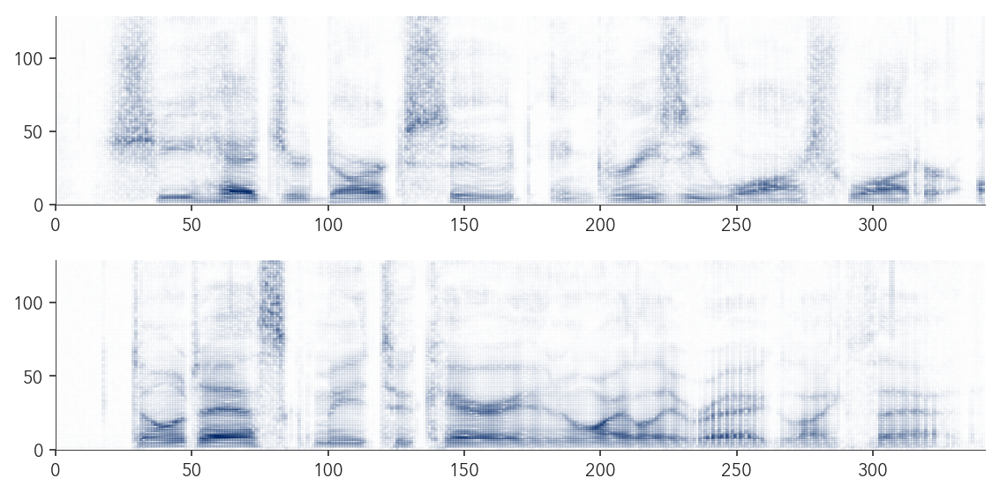

In [998]:
import librosa
from scipy.signal import stft, istft

s1,sr = librosa.core.load( '/mnt/data/timit-wav/test/dr4/flbw0/sa1.wav', sr=None, mono=True)
s1,sr = librosa.core.load( '/mnt/data/timit-wav/test/dr3/mbdg0/sa1.wav', sr=None, mono=True)


print(sr)
s2,sr = librosa.core.load( '/mnt/data/timit-wav/test/dr4/mbns0/sa2.wav', sr=None, mono=True)

print(sr)

s1 = s1[:min(len(s1),len(s2))]
s2 = s2[:min(len(s1),len(s2))]

soundsc( s1, sr)
soundsc( s2, sr)

subplot( 2, 1, 1), pcolormesh( abs( stft( s1)[2])**.3)
subplot( 2, 1, 2), pcolormesh( abs( stft( s2)[2])**.3)
tight_layout()

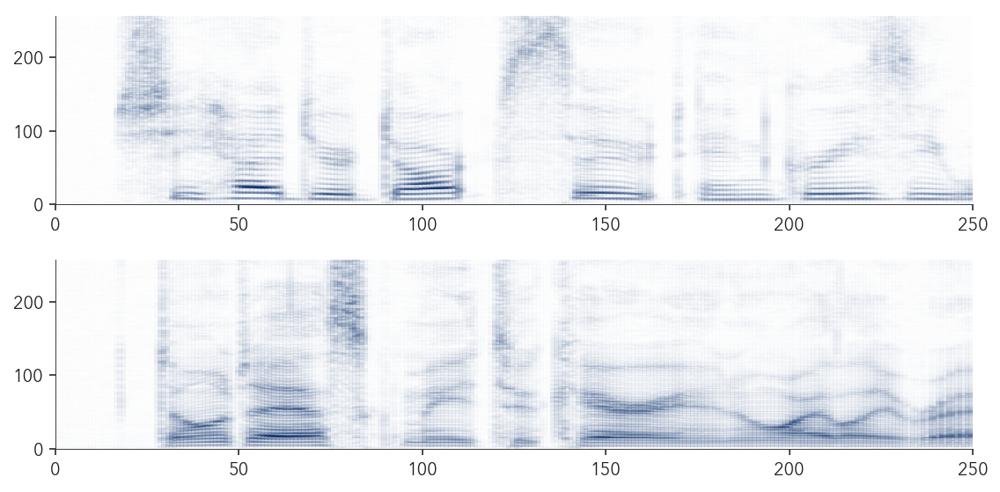

In [999]:
# just in order to check if our loader returns the same
import os, sys, librosa, matplotlib, plotly
import numpy as np 
from pprint import pprint 
from sklearn.cluster import KMeans
from sklearn.decomposition import FastICA
from matplotlib.pyplot import subplot, hist, tight_layout
from matplotlib.pylab import title
root_dir = '../../'
sys.path.insert(0, root_dir)
import spatial_two_mics.examples.mixture_example as me
import spatial_two_mics.utils.audio_mixture_constructor as mix_constructor
import spatial_two_mics.data_generator.source_position_generator as position_generator
import spatial_two_mics.labels_inference.tf_label_estimator as label_estimator
from spatial_two_mics.utils import robust_means_clustering as robust_kmeans
mixture_info = me.mixture_info_example()

random_positioner = position_generator.RandomCirclePositioner()
positions_info = random_positioner.get_sources_locations(2)
mixture_info['positions'] = positions_info

mixture_creator = mix_constructor.AudioMixtureConstructor(
        n_fft=512, win_len=512, hop_len=128, mixture_duration=2.0,
        force_delays=[-1,1])

tf_representations = mixture_creator.construct_mixture(mixture_info)

for i, source_tf in enumerate(tf_representations['sources_tf']):
    subplot( 2, 1, i+1), pcolormesh( abs(source_tf)**.3)
tight_layout()

In [1000]:
print(mixture_info['positions']['thetas'])

[0.65627937 2.73700113]


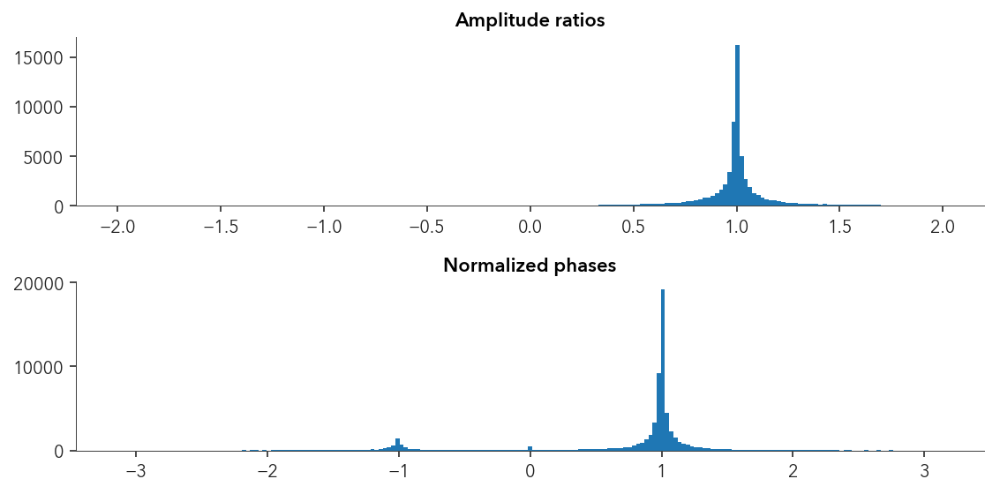

In [1001]:
# Create the mixtures
s1 = tf_representations['sources_raw'][0]
s2 = tf_representations['sources_raw'][1]
a = 0.1
alphas = [a, 1. - a]
tau = 1

turbulence = 0.005
m1 = alphas[0]*s1[:-tau] + alphas[1]*s2[tau:]
m2 = (alphas[0]+turbulence)*s1[tau:] + (alphas[1]-turbulence)*s2[:-tau]
m2 = (alphas[0])*s1[tau:] + (alphas[1])*s2[:-tau]

n_fft = 512
hop_length = 128
f1 = librosa.core.stft(m1, n_fft=n_fft, hop_length=hop_length, win_length=n_fft)
f2 = librosa.core.stft(m2, n_fft=n_fft, hop_length=hop_length, win_length=n_fft)
# f1 = stft(m1)[2]
# f2 = stft(m2)[2]

# r = log( f1 / (f2+1e-7))
r = f1 / (f2+1e-7)

# Log amplitude difference
a = abs( r)

# Phase difference, normalized by frequency
p = np.angle( r) / linspace( 1e-5, np.pi, f1.shape[0])[:,None]
# p = (np.angle(f1) - np.angle(f2))/ linspace( 1e-5, pi, f1.shape[0])[:,None]
# p = (np.angle(f1) - np.angle(f2)) / linspace( 1e-5, pi, f1.shape[0])[:,None]

# Show me
subplot( 2, 1, 1), hist( a.reshape( -1), linspace( -2, 2, 200)); title( 'Amplitude ratios')
subplot( 2, 1, 2), hist( p.reshape( -1), linspace( -pi, pi, 200)); title( 'Normalized phases')
# plot(), hist( p.reshape( -1), linspace( -pi, pi, 200)); title( 'Normalized phases')
tight_layout()


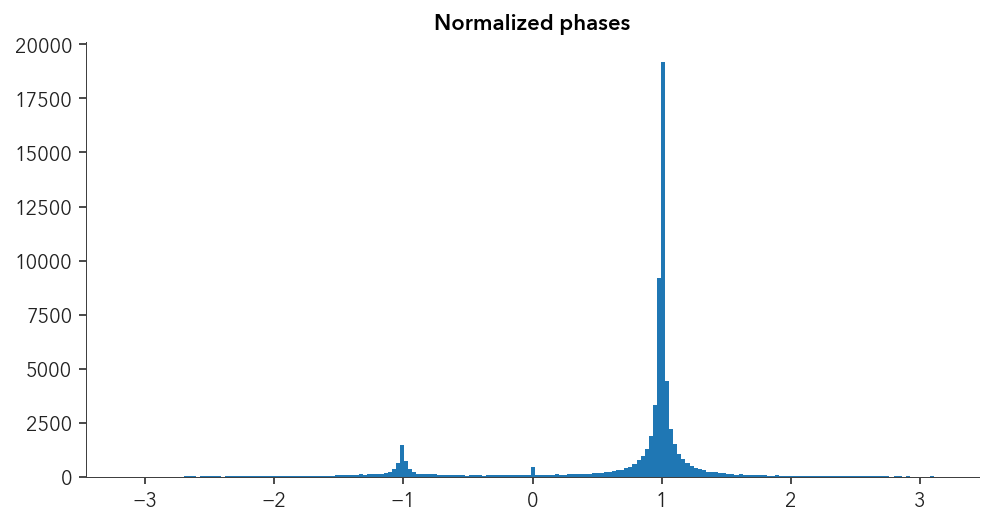

In [1002]:

hist( p.reshape( -1), linspace( -pi, pi, 200)); title( 'Normalized phases')
plt.show()

In [1003]:
# now let us try the same thing but with a randomly provided delay 
#  for the sources 
delays_for_sources = positions_info['taus']
delays_for_sources = np.array([-0.85, .95])
print(delays_for_sources)

[-0.85  0.95]


/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:5: DeprecationWarning:

object of type <class 'float'> cannot be safely interpreted as an integer.

/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:7: DeprecationWarning:

object of type <class 'float'> cannot be safely interpreted as an integer.



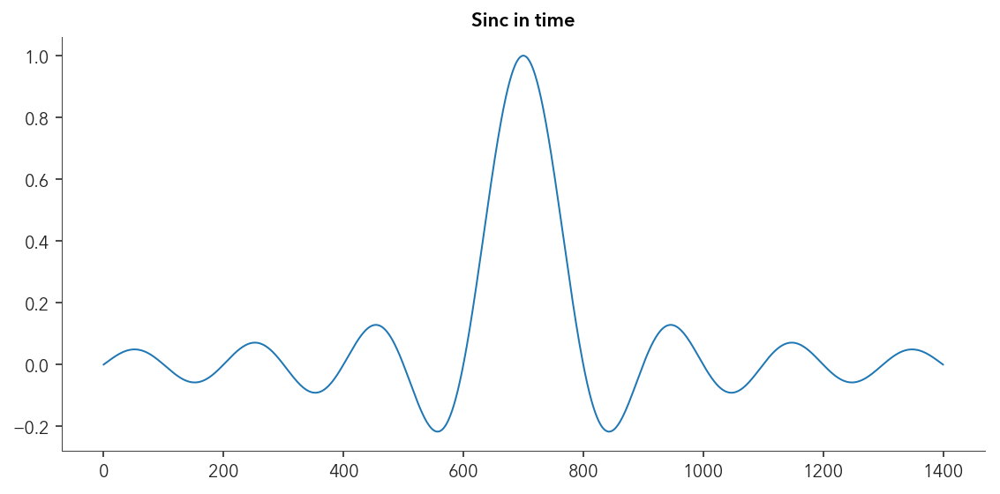

In [1004]:
# plot the sinc function 
precision = 0.01
freqs_included = 7
xs = np.linspace(-freqs_included*sr, freqs_included*sr, 
                 2.*freqs_included/precision)
xs = np.linspace(-freqs_included, freqs_included, 
                 2.*freqs_included/precision)
windowed_sinc = np.sinc(xs)
# /(1. * sr)
plot(windowed_sinc)
title("Sinc in time")
tight_layout()

99
31999


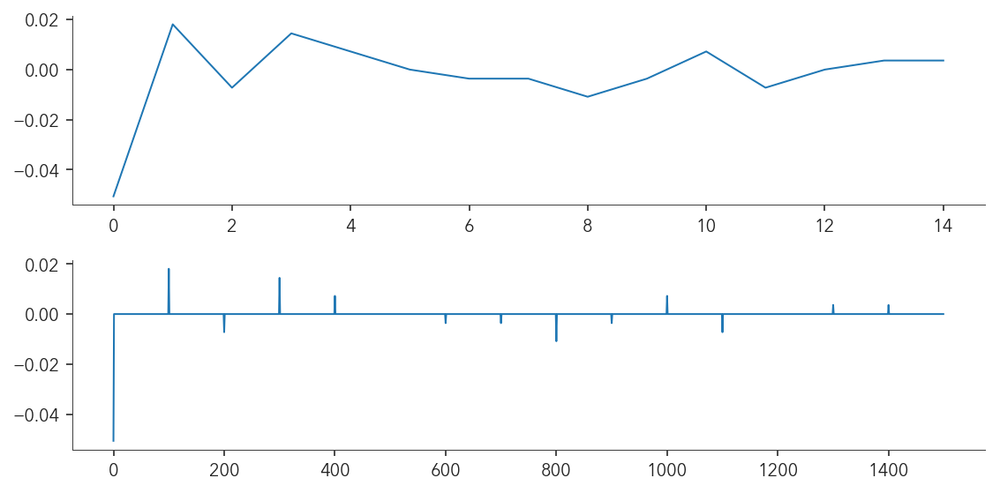

In [1005]:
# now we need to convolve this window with all of the but also upsample 
signal = s1 
sig_len = signal.shape[0]
n_augmentation_zeros = int(1. / precision) - 1
augmented_signal = np.zeros(sig_len + (sig_len-1)*n_augmentation_zeros)
augmented_signal[::n_augmentation_zeros+1] = signal

print(n_augmentation_zeros)     
print(sig_len)
subplot( 2, 1, 1), plot(signal[:15])
subplot( 2, 1, 2), plot(augmented_signal[:15*(n_augmentation_zeros+1)])
tight_layout()

(<matplotlib.axes._subplots.AxesSubplot at 0x7fe19be63898>,
 [<matplotlib.lines.Line2D at 0x7fe1ca2acb70>])

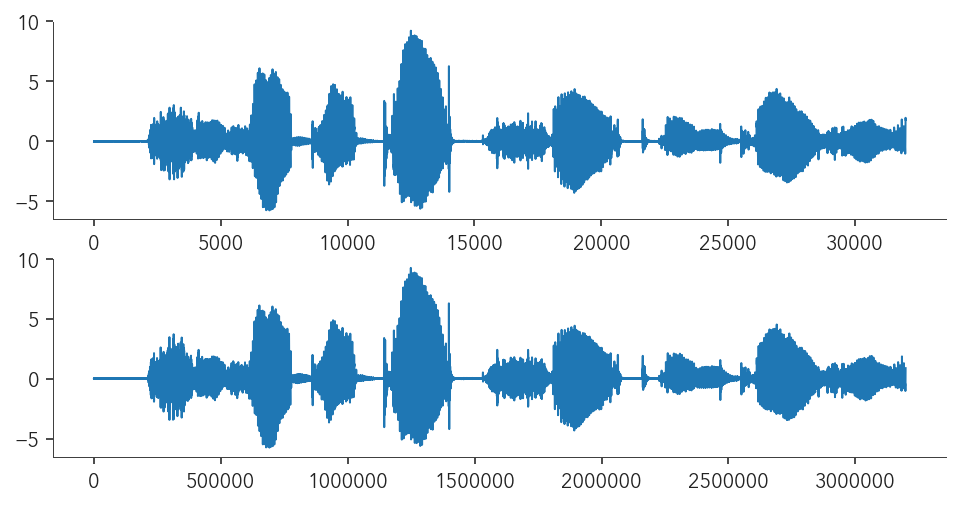

In [1006]:
# make the convolution with the augmented signal after zero padding 
est_augmented_sig = np.convolve(augmented_signal, windowed_sinc, mode='valid')
subplot( 2, 1, 1), plot(signal)
subplot( 2, 1, 2), plot(est_augmented_sig)

(<matplotlib.axes._subplots.AxesSubplot at 0x7fe1ca195320>,
 [<matplotlib.lines.Line2D at 0x7fe1c0eee9b0>])

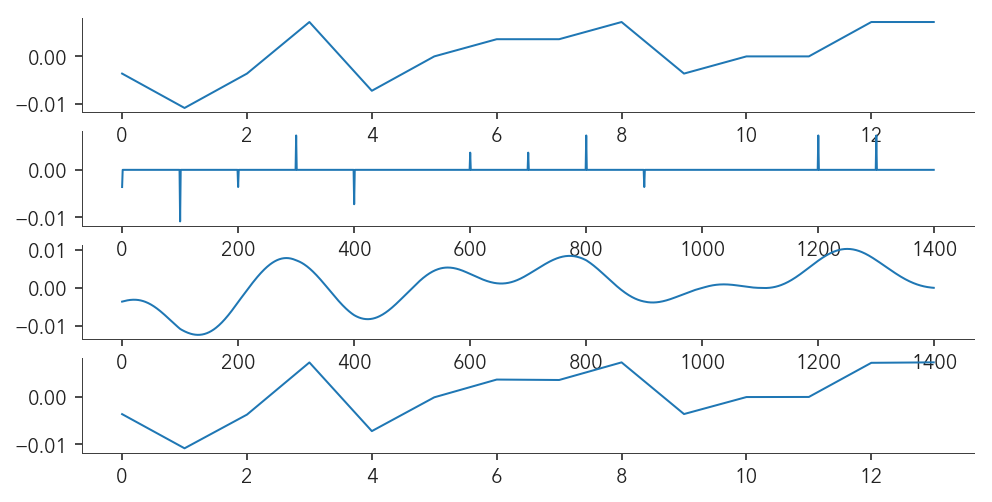

In [1007]:
# just to make sure resample in order to check the initila signal the initial signal 
reconstructed_sig = est_augmented_sig[::n_augmentation_zeros+1]

subplot( 4, 1, 1), plot(signal[freqs_included:3*freqs_included])
subplot( 4, 1, 2), plot(augmented_signal[freqs_included*(n_augmentation_zeros+1):3*freqs_included*(n_augmentation_zeros+1)])
subplot( 4, 1, 3), plot(est_augmented_sig[:2*freqs_included*(n_augmentation_zeros+1)])
subplot( 4, 1, 4), plot(reconstructed_sig[:2*freqs_included]) #; title("Reconstructed after augmentation")


In [1008]:
# now in order to make the delay we have the augmented signal 
# so we round the delays up to a specific precision we have selected 
decimals = int(np.log10(1. / precision))
rounded_taus = np.around(delays_for_sources, decimals=decimals)
print(decimals)
print(rounded_taus)

2
[-0.85  0.95]


In [1009]:
# samples needed to be rotated over the time axis in order to meet the delays that are generated 
taus_samples = int(1./precision) * rounded_taus
taus_samples = taus_samples.astype(int)
print(taus_samples)

[-85  95]


In [1010]:
# now in case of a positive delay we would have to forward the signal in the first microphone 
# or delay it otherwise by the number of samples that is defined for the corresponding source
source_signals = [s1, s1]
upsampling_rate = int(1. / precision)
n_augmentation_zeros = upsampling_rate - 1

mics_sources = [[], []]
for src_id, source_sig in enumerate(source_signals):
    sig_len = source_sig.shape[0]
    augmented_signal = np.zeros(int(sig_len + (sig_len-1)*n_augmentation_zeros))
    augmented_signal[::n_augmentation_zeros+1] = source_sig
    
    tau_in_samples = taus_samples[src_id]
    if tau_in_samples > 0:
        mics_sources[0].append(est_augmented_sig[tau_in_samples:][::upsampling_rate])
        mics_sources[1].append(est_augmented_sig[:-tau_in_samples][::upsampling_rate])
    elif tau_in_samples < 0:
        mics_sources[0].append(est_augmented_sig[-tau_in_samples:][::upsampling_rate])
        mics_sources[1].append(est_augmented_sig[:tau_in_samples][::upsampling_rate])
    else:        
        mics_sources[0].append(est_augmented_sig[::upsampling_rate])
        mics_sources[1].append(est_augmented_sig[::upsampling_rate])

for mic_ind, mic_sources_list in enumerate(mics_sources):
    print(len(mic_sources_list[0]))
    print(len(mic_sources_list[1]))

31984
31984
31984
31984


In [1011]:
# now let's write it in a proper function 
def enforce_float_delays(source_signals,  
                         delays_for_sources,
                         fs, 
                         precision=0.01, 
                         duration=2.0, 
                         freqs_included = 5):
    """!
    For 2 microphone enforce a floating point number delay with some selected precision and
    apply that for all sources that would be given. Also make sure that the required to be 
    returned wavs have to have a length equal to the duration"""
    upsampling_rate = int(1. / precision)
    duration_in_samples = int(duration * fs)
    decimals = int(np.log10(upsampling_rate))
    
    rounded_taus = np.around(delays_for_sources, decimals=decimals)
    taus_samples = upsampling_rate * rounded_taus
    taus_samples = taus_samples.astype(int)
    
    print(taus_samples)
    
    xs = np.linspace(-freqs_included, freqs_included, 
                     2.*freqs_included/precision)
    windowed_sinc = np.sinc(xs)
    
    mics_sources = [[], []]
    for src_id, source_sig in enumerate(source_signals):
        sig_len = source_sig.shape[0]
        augmented_signal = np.zeros(sig_len + (sig_len-1)*n_augmentation_zeros)
        augmented_signal[::upsampling_rate] = source_sig
        est_augmented_sig = np.convolve(augmented_signal, 
                                        windowed_sinc, 
                                        mode='valid')

        tau_in_samples = taus_samples[src_id]
        if tau_in_samples > 0:
            source_in_mic1 = est_augmented_sig[
                             tau_in_samples:][::upsampling_rate]
            source_in_mic2 = est_augmented_sig[
                             :-tau_in_samples][::upsampling_rate]
        elif tau_in_samples < 0:
            source_in_mic1 = est_augmented_sig[
                             :tau_in_samples][::upsampling_rate]
            source_in_mic2 = est_augmented_sig[
                             -tau_in_samples:][::upsampling_rate]
        else:
            source_in_mic1 = est_augmented_sig[::upsampling_rate]
            source_in_mic2 = est_augmented_sig[::upsampling_rate]
            
        # check the duration which is very important 
        if (len(source_in_mic1) < duration_in_samples or  
            len(source_in_mic2) < duration_in_samples):
            raise ValueError("Duration given: {} could "
                  "not be sufficed before the gven source"
                  " signal has a lesser duration of {} "
                  "after the float delay.".format(
                  duration_in_samples, len(source_in_mic1)))
            
        mics_sources[0].append(source_in_mic1[:duration_in_samples])
        mics_sources[1].append(source_in_mic2[:duration_in_samples])
    
    return mics_sources 

In [1012]:
s1 = tf_representations['sources_raw'][0]
s2 = tf_representations['sources_raw'][1]
print(delays_for_sources)
mics_sources = enforce_float_delays([s1, s2], delays_for_sources,
                                    16000, duration=1.9, freqs_included=7, precision=0.01)
pprint(mics_sources)

[-0.85  0.95]
[-85  95]


/home/thymios/.local/lib/python3.5/site-packages/ipykernel_launcher.py:23: DeprecationWarning:

object of type <class 'float'> cannot be safely interpreted as an integer.



[[array([-0.00361643, -0.01080781, -0.00371576, ...,  0.04324478,
       -0.13034605, -0.36548144]),
  array([ 0.00964795,  0.00082591, -0.0035208 , ..., -0.30486449,
       -0.33674038, -0.3652498 ])],
 [array([-0.00875703, -0.00681419,  0.00786091, ..., -0.11525666,
       -0.34516187, -0.58194309]),
  array([-4.22358691e-05,  9.69437383e-03,  7.15420297e-05, ...,
       -3.33290393e-01, -3.03566752e-01, -3.35706759e-01])]]


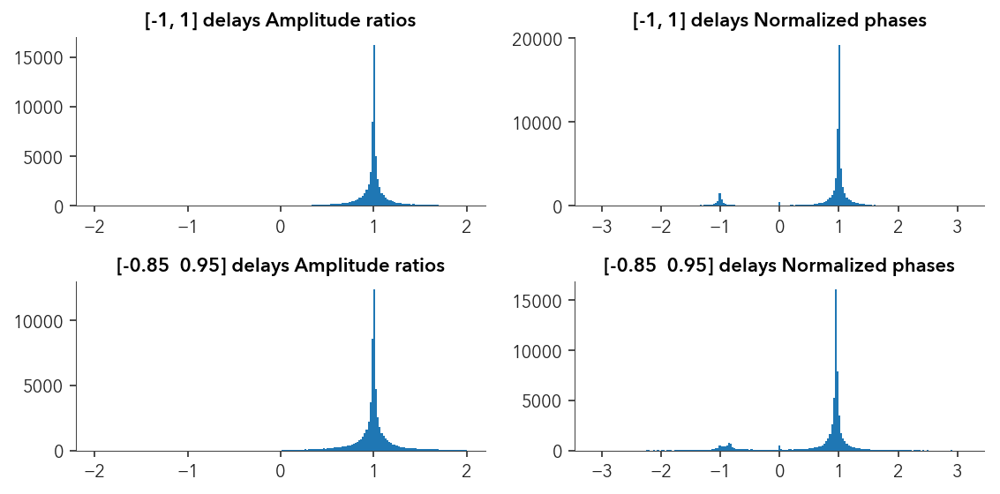

In [1013]:
# now let's see how the phase changes from the previous no delay version 
m1 = alphas[0]*mics_sources[0][0] + alphas[1]*mics_sources[0][1]
m2 = alphas[0]*mics_sources[1][0] + alphas[1]*mics_sources[1][1]

n_fft = 512
hop_length = 128
f1_f_delayed = librosa.core.stft(m1, n_fft=n_fft, hop_length=hop_length, win_length=n_fft)
f2_f_delayed = librosa.core.stft(m2, n_fft=n_fft, hop_length=hop_length, win_length=n_fft)
# f1 = stft(m1)[2]
# f2 = stft(m2)[2]

# r = log( f1 / (f2+1e-7))
r_f_delayed = f1_f_delayed / (f2_f_delayed+1e-7)

# Log amplitude difference
a_f_delayed = abs( r_f_delayed)

# Phase difference, normalized by frequency
p_f_delayed = np.angle( r_f_delayed) / linspace( 1e-5, np.pi, f1_f_delayed.shape[0])[:,None]
# p = (np.angle(f1) - np.angle(f2))/ linspace( 1e-5, pi, f1.shape[0])[:,None]
# p = (np.angle(f1) - np.angle(f2)) / linspace( 1e-5, pi, f1.shape[0])[:,None]

# Show me
subplot( 2, 2, 1), hist( a.reshape( -1), linspace( -2, 2, 200)); title( '[-1, 1] delays Amplitude ratios')
subplot( 2, 2, 2), hist( p.reshape( -1), linspace( -pi, pi, 200)); title( '[-1, 1] delays Normalized phases')

subplot( 2, 2, 3), hist( a_f_delayed.reshape( -1), linspace( -2, 2, 200)); title( 
                   '{} delays Amplitude ratios'.format(rounded_taus))
subplot( 2, 2, 4), hist( p_f_delayed.reshape( -1), linspace( -pi, pi, 200)); title( 
                   '{} delays Normalized phases'.format(rounded_taus))
# plot(), hist( p.reshape( -1), linspace( -pi, pi, 200)); title( 'Normalized phases')
tight_layout()

In [1014]:
# Plotly Functions 
import plotly
import plotly.tools as tls
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

def plot_tf_representation(tf, for_title = '', fs=16000, duration=2.0, log_scale=False):
    freq_max, time_max = tf.shape
    bins = np.arange(time_max)
    bins = (duration * bins) / time_max 
    freqs = np.arange(freq_max)
    freqs = (freqs * fs) / (2.0 * freq_max) 
    trace = [go.Heatmap(
        x= bins,
        y= freqs,
#         z= 10*np.log10(Pxx),
        z = 10*np.log10(tf) if log_scale else tf,
        colorscale='Jet',
        )]
    layout = go.Layout(
        title = 'Spectrogram '+for_title,
        yaxis = dict(title = 'Frequency'), # x-axis label
        xaxis = dict(title = 'Time'), # y-axis label
        )
    fig = dict(data=trace, layout=layout)
    plotly.offline.iplot(fig, filename=for_title)

In [1015]:
# let's check how these features go compared to the ground truth mask 
ground_truth_estimator = label_estimator.TFMaskEstimator(
                             inference_method='Ground_truth') 
tf_representations['amplitudes'] = alphas 
tf_representations['sources_tf'] = [librosa.core.stft(mics_sources[0][0], n_fft=n_fft, 
                                                      hop_length=hop_length, win_length=n_fft), 
                                    librosa.core.stft(mics_sources[0][1], n_fft=n_fft, 
                                                      hop_length=hop_length, win_length=n_fft)]
gt_labels = ground_truth_estimator.infer_mixture_labels(tf_representations)
plot_tf_representation(gt_labels, for_title = 'Ground Truth Mask', log_scale=False)

In [1028]:
# now perform the analysis for duet soft labeling
phase_dif = p_f_delayed
n_sources = len(tf_representations['sources_tf'])
d_feature = np.reshape(phase_dif, (np.product(phase_dif.shape), 1))

used_clusters = 9
r_kmeans = robust_kmeans.RobustKmeans(n_true_clusters=2, n_used_clusters=used_clusters)
# kmeans = KMeans(n_clusters=clusters, random_state=7).fit(d_feature)
d_labels = r_kmeans.fit(d_feature)
d_feature_mask = np.reshape(d_labels, phase_dif.shape)
plot_tf_representation(d_feature_mask, 
                       for_title = ' Phase Diff only using Robust {}-means => 2 clusters'.format(used_clusters), 
                       log_scale=False)
# print(d_labels)

In [1017]:
# check the duet features how they scatter 
gt_flatten = gt_labels.reshape(1,-1)
xyl = np.concatenate((duet_features, gt_flatten.T), axis=1) 

# clip high norm values and also random sampling
xyl = np.clip(xyl, -1., 1.)
rand_ind = np.random.choice(np.arange(xyl.shape[0]), size=3000, replace=False)
xyl = xyl[rand_ind, :]


N = xyl.shape[0]
pred0 = xyl[xyl[:,2]==0]
pred1 = xyl[xyl[:,2]==1]

title = 'Scatter of DUET features for Ground Truth Masking'

trace0 = go.Scatter(
    x = pred0[:,0],
    y = pred0[:,1],
    name = 'Source 1',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgba(152, 0, 0, .8)',
        line = dict(
            width = 2,
            color = 'rgb(0, 0, 0)'
        )
    )
)

trace1 = go.Scatter(
    x = pred1[:,0],
    y = pred1[:,1],
    name = 'Source 2',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgba(255, 182, 193, .9)',
        line = dict(
            width = 2,
        )
    )
)

# also check the clusters from Kmeas 
kmeans_sol = KMeans(n_clusters=used_clusters, random_state=7).fit(d_feature)
clusters_xy = kmeans_sol.cluster_centers_
print(clusters_xy)
print(d_feature.max())
cluster_traces = []
for cl_ind in np.arange(clusters_xy.shape[0]):
    x_cl = clusters_xy[cl_ind]
    trace_cl = go.Scatter(
        x = x_cl,
        y = [0.],
        name = 'Cluster {}'.format(cl_ind + 1),
        mode = 'markers',
        marker = dict(
            size = 10,
            symbol = 'x-open',
            line = dict(
                width = 4,
            )
        )
    )
    cluster_traces.append(trace_cl)
    

data = [trace0, trace1] + cluster_traces

layout = dict(title = 'Scatter for Robust kmeans using many clusters',
              yaxis = dict(zeroline = False, title='Attenuation'),
              xaxis = dict(zeroline = False, title = 'Phase Difference')
             )

fig = dict(data=data, layout=layout)
plotly.offline.iplot(fig, filename=title)

[[ 9.24875512e-01]
 [-3.14159274e+05]
 [-8.77768140e-01]
 [ 8.01700343e+00]
 [ 2.38969631e+00]
 [-7.30262107e+00]
 [ 1.11733749e-01]
 [-1.92647308e+00]
 [ 1.23402064e+00]
 [ 2.03497636e+01]]
23.138256862192748


In [1018]:
plot_tf_representation(p_f_delayed, 
                       for_title = ' Phase Difference', 
                       log_scale=False)

In [1029]:
# create an even more robust k-means 
# print(p_f_delayed.shape)
# print(np.abs(p_f_delayed).max())
# print(np.unravel_index(np.abs(p_f_delayed).argmax(), p_f_delayed.shape))
# outlier_mask = np.where(np.abs(d_feature)>1.)
abs_diff = np.abs(d_feature)
robust_estimators = d_feature[np.where(abs_diff<= 2.)].reshape(-1, 1)

# print(np.mean(robust_estimators))

# robust_estimators = d_feature[np.where(abs_diff - np.mean(abs_diff)<= 0.01 * np.std(abs_diff))].reshape(-1, 1)
# outliers = d_feature[outlier_mask]
# create the clustering by throwing away the outliers
kmeans_sol = KMeans(n_clusters=2, random_state=7).fit(robust_estimators)
robust_d_pred = kmeans_sol.predict(d_feature).reshape(phase_dif.shape)
print(d_feature.shape)
print(robust_d_pred.shape)
# .reshape(phase_dif.shape)
plot_tf_representation(1-robust_d_pred, 
                       for_title = ' Phase Diff only using Outlier Robust 2-means =>',
                       log_scale=False)

(61166, 1)
(257, 238)


In [1020]:
# ## from sklearn import cluster, datasets, mixture
# from sklearn.neighbors import kneighbors_graph
# from sklearn.preprocessing import StandardScaler
# from itertools import cycle, islice 

# attenuation = abs(r_f_delayed)
# smoothed_attenuation = attenuation - (1. / attenuation)
# smoothed_attenuation_feature = np.reshape(smoothed_attenuation, (np.product(smoothed_attenuation.shape), 1))
# duet_features = np.concatenate((d_feature, smoothed_attenuation_feature), axis=1)

# used_clusters = 3
# r_kmeans = robust_kmeans.RobustKmeans(n_true_clusters=2, n_used_clusters=used_clusters)
# # kmeans = KMeans(n_clusters=clusters, random_state=7).fit(d_feature)
# duet_labels = r_kmeans.fit(duet_features)
# duet_mask = np.reshape(duet_labels, phase_dif.shape)
# plot_tf_representation(duet_mask, 
#                        for_title = ' DUET features using Robust {}-means => 2 clusters'.format(used_clusters), 
#                        log_scale=False)

In [1021]:
# check the duet features how they scatter 
gt_flatten = gt_labels.reshape(1,-1)
xyl = np.concatenate((duet_features, gt_flatten.T), axis=1) 

# clip high norm values and also random sampling
xyl = np.clip(xyl, -1., 1.)
rand_ind = np.random.choice(np.arange(xyl.shape[0]), size=3000, replace=False)
xyl = xyl[rand_ind, :]


N = xyl.shape[0]
pred0 = xyl[xyl[:,2]==0]
pred1 = xyl[xyl[:,2]==1]

title = 'Scatter of DUET features for Ground Truth Masking'

trace0 = go.Scatter(
    x = pred0[:,0],
    y = pred0[:,1],
    name = 'Source 1',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgba(152, 0, 0, .8)',
        line = dict(
            width = 2,
            color = 'rgb(0, 0, 0)'
        )
    )
)

trace1 = go.Scatter(
    x = pred1[:,0],
    y = pred1[:,1],
    name = 'Source 2',
    mode = 'markers',
    marker = dict(
        size = 5,
        color = 'rgba(255, 182, 193, .9)',
        line = dict(
            width = 2,
        )
    )
)

# also check the clusters from Kmeans 
clusters_xy = kmeans_sol.cluster_centers_
print(clusters_xy)
print(d_feature.max())
cluster_traces = []
for cl_ind in np.arange(clusters_xy.shape[0]):
    x_cl = clusters_xy[cl_ind]
    trace_cl = go.Scatter(
        x = x_cl,
        y = [0.],
        name = 'Cluster {}'.format(cl_ind + 1),
        mode = 'markers',
        marker = dict(
            size = 10,
            line = dict(
                width = 4,
            )
        )
    )
    cluster_traces.append(trace_cl)
    

data = [trace0, trace1] + cluster_traces

layout = dict(title = 'Styled Scatter',
              yaxis = dict(zeroline = False, title='Attenuation'),
              xaxis = dict(zeroline = False, title = 'Phase Difference')
             )

fig = dict(data=data, layout=layout)
plotly.offline.iplot(fig, filename=title)

[[ 0.94468124]
 [-0.77531249]]
23.138256862192748


In [1022]:
# # now run multiple clustering algorithms in order to see how it goes:
# gmm = mixture.GaussianMixture(
#       n_components=n_sources, covariance_type='full')
# spectral = cluster.SpectralClustering(
#         n_clusters=n_sources, eigen_solver='arpack',
#         affinity="nearest_neighbors")
# kmeans = KMeans(n_clusters=n_sources, random_state=0)

# clustering_algorithms = (
#         ('Kmeans', kmeans),
#         ('SpectralClustering', spectral),
#         ('GaussianMixture', gmm)
#     )

In [1023]:
def get_mask_representation(mask, gt, for_title, fs=16000., 
                            log_scale=False):
    freq_max, time_max = mask.shape
    bins = np.arange(time_max)
    bins = (duration * bins) / time_max 
    freqs = np.arange(freq_max)
    freqs = (freqs * fs) / (2.0 * freq_max) 
    trace = [go.Heatmap(
        x= bins,
        y= freqs,
        z = 10*np.log10(mask) if log_scale else mask,
        colorscale='Jet',
        )]
#     also plot the difference from the true mask 
    trace2 = [go.Heatmap(
        x= bins,
        y= freqs,
        z = abs(mask-gt),
        colorscale='Jet',
        )]
    
    layout = go.Layout(
        title = for_title,
        yaxis = dict(title = 'Frequency'), # x-axis label
        xaxis = dict(title = 'Time'), # y-axis label
        )
    fig = dict(data=trace, layout=layout)
    plotly.offline.iplot(fig, filename=for_title)

In [1024]:
# X = duet_features
# plot_num = 1
# for name, algorithm in clustering_algorithms:
#     t0 = time.time()

#     # catch warnings related to kneighbors_graph
#     with warnings.catch_warnings():
#         warnings.filterwarnings(
#             "ignore",
#             message="the number of connected components of the " +
#             "connectivity matrix is [0-9]{1,2}" +
#             " > 1. Completing it to avoid stopping the tree early.",
#             category=UserWarning)
#         warnings.filterwarnings(
#             "ignore",
#             message="Graph is not fully connected, spectral embedding" +
#             " may not work as expected.",
#             category=UserWarning)
#         algorithm.fit(X)

#     t1 = time.time()
#     if hasattr(algorithm, 'labels_'):
#         y_pred = algorithm.labels_
#     else:
#         y_pred = algorithm.predict(X)
    
#     duet_mask = np.reshape(y_pred, phase_dif.shape)
#     title = 'Algorithm: {} run in {} seconds'.format(name, t1-t0 )
# #     plot_tf_representation(duet_mask, gt_labels, title, log_scale=False)
#     plot_tf_representation(duet_mask, for_title=title, log_scale=False)

In [1025]:
def bss_eval( sep, i, sources):
    # Current target
    from numpy import dot, linalg, log10
    min_len = min([len(sep), len(sources[i])])
    sources = sources[:,:min_len]
    sep = sep[:min_len]
    target = sources[i]

    # Target contribution
    s_target = target * dot( target, sep.T) / dot( target, target.T)

    # Interference contribution
    pse = dot( dot( sources, sep.T), \
    linalg.inv( dot( sources, sources.T))).T.dot( sources)
    e_interf = pse - s_target

    # Artifact contribution
    e_artif= sep - pse;

    # Interference + artifacts contribution
    e_total = e_interf + e_artif;

    # Computation of the log energy ratios
    sdr = 10*log10( sum( s_target**2) / sum( e_total**2));
    sir = 10*log10( sum( s_target**2) / sum( e_interf**2));
    sar = 10*log10( sum( (s_target + e_interf)**2) / sum( e_artif**2));

    return (sdr, sir, sar)

In [1026]:
# try to evaluate the reconstructed signals 
d_feature = np.reshape(phase_dif, (np.product(phase_dif.shape), 1))

r_kmeans = robust_kmeans.RobustKmeans(n_true_clusters=2, n_used_clusters=used_clusters)
# kmeans = KMeans(n_clusters=clusters, random_state=7).fit(d_feature)
duet_labels = r_kmeans.fit(d_feature)
duet_mask = np.reshape(duet_labels, phase_dif.shape)
gt_mask = gt_labels 

for i in np.arange(n_sources):
    d_stft = abs(f1_f_delayed)*(duet_mask==i).reshape(f1_f_delayed.shape)
    gt_stft = abs(f1_f_delayed)*(gt_mask==i).reshape(f1_f_delayed.shape)
    plot_tf_representation(d_stft, for_title='Duet reconstructed STFT')
    plot_tf_representation(gt_stft, for_title='Ground truth reconstructed STFT')

In [1027]:
stft_rec = []
stft_gt = []

sources = np.array([s1, s2])
# sources = np.array([alphas[0]*s1, alphas[1]*s2])
fs = 16000
for i in np.arange(n_sources):
    d_stft = f1_f_delayed*(duet_mask==i).reshape(f1_f_delayed.shape)
    gt_stft = f1_f_delayed*(gt_mask==i).reshape(f1_f_delayed.shape)
    
    
    d_s_rec = librosa.core.istft( d_stft, 
                                 hop_length=hop_length, win_length=n_fft)
    gt_s_rec = librosa.core.istft( gt_stft, 
                                 hop_length=hop_length, win_length=n_fft)

    soundsc( d_s_rec, fs, 'Librosa Duet Reconstructed Signal for Source: {}'.format(i))
    (sdr, sir, sar) = bss_eval( d_s_rec, 0, np.array(mics_sources[0]))
    print((sdr, sir, sar))
    (sdr, sir, sar) = bss_eval( d_s_rec, 1, np.array(mics_sources[0]))
    print((sdr, sir, sar))
    
    soundsc( gt_s_rec, fs, 'Ground Truth Reconstructed Signal for Source: {}'.format(i))
    (sdr, sir, sar) = bss_eval( gt_s_rec, 0, np.array(mics_sources[0]))
    print((sdr, sir, sar))
    (sdr, sir, sar) = bss_eval( gt_s_rec, 1, np.array(mics_sources[0]))
    print((sdr, sir, sar))

Librosa Duet Reconstructed Signal for Source: 0


(1.352782267963422, 44.486614455230296, 1.3531478971555213)
(-41.88065726080144, -39.49423611202084, 1.3531478971555213)


Ground Truth Reconstructed Signal for Source: 0


(2.168517535657423, 38.945784449611054, 2.1699833404952247)
(-38.01842216906128, -35.958553866020075, 2.1699833404952247)


Librosa Duet Reconstructed Signal for Source: 1


(-24.139479571406163, -24.126691908535012, 25.320296040121523)
(22.036262091736816, 24.801801639328175, 25.320296040121523)


Ground Truth Reconstructed Signal for Source: 1


(-25.645404058689145, -25.631228138326758, 24.86710013192239)
(22.566298357724676, 26.43921770418153, 24.86710013192239)
